In [1]:
#
import mne
import os
import scipy.io
import listen_italian_functions
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns
import matplotlib as mpl
from mne.stats import permutation_cluster_test
from mne.stats import permutation_cluster_1samp_test
from functools import partial
from mne.stats import ttest_1samp_no_p, permutation_t_test,fdr_correction,spatio_temporal_cluster_1samp_test
from IPython.display import clear_output
from itertools import permutations,combinations
#sns.set(style="darkgrid")
sns.set(font_scale=1.5)
from scipy import stats

data_path = os.path.dirname(os.getcwd())

subject_name = ['Alice','Andrea','Daniel','Elena','Elenora','Elisa','Federica','Francesca','Gianluca1','Giada','Giorgia',
                'Jonluca','Laura','Leonardo','Linda','Lucrezia','Manu','Marco','Martina','Pagani','Pasquale','Sara',
                'Silvia','Silvia2','Tommaso']
#subject_name = ['Alice','Andrea','Daniel','Elena','Elenora','Elisa','Federica','Francesca','Gianluca1','Giada','Giorgia',                'Jonluca','Laura','Leonardo','Linda','Lucrezia','Manu','Marco','Martina','Pagani','Pasquale',                'Silvia','Silvia2','Tommaso']

subject_name = ['Alice']

trial_len = 3
remove_first = 0.5 #seconds

save_path = data_path + '/data/coherence'

info = mne.io.read_raw_fif((save_path+'-info'),preload=True)
clear_output()

In [2]:
mode = 'multitaper'  # multitaper  fourier
method = 'coh'
frsmooth = 2
pad=6
trial_len=2
time_bandwidth = 2.5
delay = np.arange(-5,5.25,0.25) / 10

#delay = np.arange(-5,5.5,0.5) / 10


In [3]:
# data coherence from fieldtrip

# worked
#raw_fname = data_path + '/entrainment_python_old/coh_fieldtrip_freqdeptsmoothDPSS_0.5-15.mat'



#raw_fname = data_path + '/entrainment_python_old/coh_fieldtrip_'+str(frsmooth)+'hzsmoothDPSS_0.25-14.75Hz-2.mat'
#raw_fname = data_path + '/entrainment_python_old/coh_fieldtrip_'+str(frsmooth)+'hzsmoothDPSS_0.5-15Hz-2.mat'
raw_fname = data_path + '/entrainment_python_old/coh_fieldtrip_'+str(frsmooth)+'hzsmoothDPSS_1-15Hz-2.mat'
raw_fname = data_path + '/entrainment_python_old/coh_fieldtrip_pad_'+str(pad)+'_'+str(frsmooth)+'hzsmoothDPSS_0.5-15Hz-2.mat'


mat = scipy.io.loadmat(raw_fname)

envelop = mat['envelop']
lip = mat['lip']
freqs = mat['freq'][0]
envelop_freq = mat['envelop_freq']
lip_freq = mat['lip_freq']

#freqs = np.arange(0.5,15.5,0.5)

con = 'All'
frames=[]
for s in range(0,len(subject_name)):
    for d in range(0,len(delay)):        
        for fr in range(0,len(freqs)):
            df = pd.DataFrame({'Condition':con,'Freq':envelop_freq[s,fr,d],'Delay':delay[d],
                               'Subject':subject_name[s],
                               'Feature':'envelop','Data':[envelop[s,:,fr,d]]})
            frames.append(df) 

            df = pd.DataFrame({'Condition':con,'Freq':lip_freq[s,fr,d],'Delay':delay[d],
                               'Subject':subject_name[s],
                               'Feature':'lipaparature','Data':[lip[s,:,fr,d]]})
            frames.append(df) 
    print(str(d)+'-'+subject_name[s])
clear_output()    
data=pd.concat((frames),axis=0)
a  = data['Data'].apply(lambda x: np.mean(x))
data['Coherence'] = pd.Series(a, index=data.index)

a = data.reset_index()

df = pd.DataFrame(np.column_stack(list(zip(*a.Data))), columns=info.ch_names)
data = pd.concat([a,df], axis=1)

data.set_index(['Feature','Freq','Condition','Delay','Subject'], inplace=True)
data.sort_index(inplace=True)


In [129]:
# data coherence from mne
save_path = data_path + '/data/coherence/'+method\
            +'-'+mode+'_timeBandwidth_'+str(time_bandwidth)+\
            '_3cycle-1-40.5Hz-0.5step_trialLength'+str(trial_len)+'.pkl'

data=pd.read_pickle(save_path)

a  = data['Data'].apply(lambda x: np.arctanh(x))
#b  = data['noTrials'].apply(lambda x: 1/(2*x-2))
#data['Data'] = pd.Series(a-b, index=data.index)

a  = data['Data'].apply(lambda x: np.mean(x))
data['Coherence'] = pd.Series(a, index=data.index)
a = data.reset_index()
df = pd.DataFrame(np.column_stack(list(zip(*a.Data))), columns=info.ch_names)
data = pd.concat([a,df], axis=1)
data.set_index(['Feature','Freq','Condition','Delay','Subject'], inplace=True)
data.sort_index(inplace=True)
data.head(2)

index  \
Feature Freq Condition Delay Subject          
TBCD    0.5  All       -0.5  Alice        0   
                             Andrea       0   

                                                                                   Data  \
Feature Freq Condition Delay Subject                                                      
TBCD    0.5  All       -0.5  Alice    [0.017760752330193464, 0.017846750359583535, 0...   
                             Andrea   [0.039569678573152384, 0.06176151852122542, 0....   

                                      noTrials  Coherence       Fp1       Fp2  \
Feature Freq Condition Delay Subject                                            
TBCD    0.5  All       -0.5  Alice         109   0.027060  0.017761  0.017847   
                             Andrea        118   0.050674  0.039570  0.061762   

                                            F7        F3        Fz        F4  \
Feature Freq Condition Delay Subject                                           
TBCD    0.5  All       -0.5  Alice    0.036638  0.020991  0.024692  0.023611   
                             Andrea   0.039975  0.064720  0.067733  0.063298   

                                        ...          TP8        P5        P1  \
Feature Freq Condition Delay Subject    ...                                    
TBCD    0.5  All       -0.5  Alice      ...     0.020340  0.023339  0.032093   
                             Andrea     ...     0.027733  0.084862  0.039550   

                                            P2        P6       PO7       PO3  \
Feature Freq Condition Delay Subject                                           
TBCD    0.5  All       -0.5  Alice    0.029463  0.025825  0.031010  0.033936   
                             Andrea   0.037801  0.055093  0.036429  0.062041   

                                           POz       PO4       PO8  
Feature Freq Condition Delay Subject                                
TBCD    0.5  All       -0.5  Alice    0.041491  0.041471  0.035039  
                             Andrea   0.040674  0.058108  0.022927  

[2 rows x 63 columns]

In [4]:
features = ['envelop','jawaopening','lipaparature','lipProtrusion','TTCD','TMCD','TBCD']

condition = ['hyper','normal','hypo','All']
condition = ['All']

freq = np.unique(data.reset_index()['Freq'])
freq

array([ 0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5,  5. ,  5.5,
        6. ,  6.5,  7. ,  7.5,  8. ,  8.5,  9. ,  9.5, 10. , 10.5, 11. ,
       11.5, 12. , 12.5, 13. , 13.5, 14. , 14.5, 15. ])

In [5]:
# functions

def draw_heatmap(*args, **kwargs):
    data = kwargs.pop('data')
    x = data['Data'].any() 
    if 'mask' in data:
        mask = data['mask'].any()
        mne.viz.plot_topomap(x, info.info, show=False,vmin=vmin,vmax=vmax,mask = mask,cmap='RdBu_r')
    else:
        mne.viz.plot_topomap(x, info.info, show=False,vmin=vmin,vmax=vmax)


def plot_topo_image(df,vmin,vmax,typeF,cmap):
    fg = sns.FacetGrid(df,col=typeF,margin_titles=True)
    b = fg.map_dataframe(draw_heatmap, 'Data')
    b = b.set_xlabels('')
    b.fig.subplots_adjust(top=0.7)
    b.fig.subplots_adjust(right=0.8)
    cbar_ax = b.fig.add_axes([0.82,0.25,0.01,0.45]) # [left, bottom, width, height] 
    norm = mpl.colors.Normalize(vmin=vmin,vmax=vmax)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    plt.colorbar(sm, ticks=np.linspace(vmin,vmax,5),cax=cbar_ax,label='Coherence')

    
def plot_topo_image2(df,vmin,vmax,typeF):
    fg = sns.FacetGrid(df,col=typeF,margin_titles=True)
    b = fg.map_dataframe(draw_heatmap, 'Data')
    b = b.set_xlabels('')
    b.fig.subplots_adjust(top=0.7)
    b.fig.subplots_adjust(right=0.8)
    cbar_ax = b.fig.add_axes([0.82,0.25,0.01,0.45]) # [left, bottom, width, height] 
    norm = mpl.colors.Normalize(vmin=vmin,vmax=vmax)
    sm = plt.cm.ScalarMappable(cmap='RdBu_r', norm=norm)
    sm.set_array([])
    plt.colorbar(sm, ticks=np.linspace(vmin,vmax,5),cax=cbar_ax,label='Coherence')
    
def get_subject_avg_inDelay(data,delay,features,freq,condition,subject_name):
    frames = []
    value = []
    for d in delay:
        A = []
        for s in subject_name:
            B = []
            for fr in freq:
                a = data.loc[features,fr,condition,d,s]['Data'].get_values()
                B.append(a[0])
            B = np.asarray(B)
            B = np.mean(B,axis=0)            
            A.append(B)
            
        A = np.asarray(A)
        A = np.mean(A,axis=0)
        df = pd.DataFrame({'Data':[A],'Delay':d})
        frames.append(df)
        value.append(min(A))
        value.append(max(A))

    df=pd.concat((frames),axis=0)
    return df,value

def get_subject_avg_inFreq(data,delay,features,freq,condition,subject_name):
    frames = []
    value = []
    for fr in freq:
        B = []
        for s in subject_name:
            a = data.loc[features,fr,condition,delay,s]['Data'].get_values()
            B.append(a[0])
            
        B = np.asarray(B)
        B = np.mean(B,axis=0)  
        df = pd.DataFrame({'Data':[B],'Freq':fr})
        frames.append(df)
        value.append(min(B))
        value.append(max(B))

    df=pd.concat((frames),axis=0)
    return df,value

def plot_delay_avg(data,delay,features,freq,condition,subject_name):
    a = data.loc[features,freq,condition,delay,subject_name]['Coherence']
    a = a.reset_index()

    g = sns.FacetGrid(a, col="Freq", row="Condition",margin_titles=True,height=8,aspect=2)
    b = g.map_dataframe(sns.tsplot, time="Delay", unit="Subject",condition="Feature", 
                        value="Coherence",color="deep")
    b = b.set_xlabels('Delay')
    b = b.set_ylabels('Coherence')
    
def plot_delay_avg_BestChannel(data,delay,features,freq,condition,subject_name,ch):
    a = data.loc[features,freq,condition,delay,subject_name][ch]
    a = a.reset_index()

    g = sns.FacetGrid(a, col="Freq", row="Condition",margin_titles=True,size=6,aspect=2)
    b = g.map_dataframe(sns.tsplot, time="Delay", unit="Subject",condition="Feature", 
                        value=ch,color="deep").add_legend()
    b = b.set_xlabels('Delay')
    b = b.set_ylabels('Coherence - ' + ch)
    
def plot_freq_avg(data,delay,features,fi,freq,condition,subject_name):
    a = data.loc[features,fi,condition,delay,subject_name]['Coherence']
    a = pd.DataFrame(a.reset_index())

    g = sns.FacetGrid(a,  col='Delay',size=6,aspect=2)
    b = g.map_dataframe(sns.tsplot, time="Freq", unit="Subject",condition="Feature", value="Coherence",
                    color="deep", err_style="ci_bars")
    b = b.set_xlabels('Frequency (Hz)')
    b = b.set_ylabels('Coherence')
    b.set(xticks=fi,xlim=(2, 17))
    b.set_xticklabels(freq,rotation=0)
    b.fig.legend(loc=1)
    b.set_titles('EEG Delayed by ' +str(delay[0])+' s')
    
    
def get_P_value_Coherence(data,features,freq_band,condition,delay,subject_name):
    A = []    
    for c in condition:
        for fr in freq_band:        
            for d in delay:
                group1 = data.loc[features[0],fr,c,d,subject_name]['Coherence']
                group2 = data.loc[features[1],fr,c,d,subject_name]['Coherence']
                p = run_permutation_test2(group1.get_values(),group2.get_values(),1000)
                a = pd.DataFrame({'Delay':d,'Freq':fr,'Condition':c,'p-value':[p]})
                A.append(a)
                
    P = pd.concat((A),axis=0)
    return P 



def get_P_value_coherence_parallel_ch(data,features,freq_band,condition,delay,subject_name,numSamples,channels):
    A = []
    
    for c in condition:
        for fr in freq_band:        
            for d in delay:
                group1 = data.loc[features[0],fr,c,d,subject_name][channels].get_values()
                group2 = data.loc[features[1],fr,c,d,subject_name][channels].get_values()
                group1 = np.asarray(group1)
                group2 = np.asarray(group2)
                AA = np.dstack((group1.T,group2.T))

                a = Parallel(n_jobs=7)(delayed(processInput)(i) for i in AA)
                for ch in range(0,len(channels)):
                    p = pd.DataFrame({'Delay':d,'Freq':fr,'Condition':c,'FeatureTest':[features],
                                      'channel':channels[ch],'p-value':a[ch]})
                    A.append(p)
                
    P = pd.concat((A),axis=0)
    return P   

def run_permutation_test2(x,y,numSamples):
    #keeping the subject association
    pooled = np.vstack([x,y]).T
    d0 = abs(x.mean() - y.mean())
    d = np.zeros((numSamples,))
    for k in range(numSamples):
        for i in range(len(x)):
            a = pooled[i]
            np.random.shuffle(a)
            pooled[i] = a
            
        starZ = pooled[:,0]
        starY = pooled[:,1]    
        d[k] = abs(starZ.mean() - starY.mean())

    p = len(np.where( d > d0 )[0])
    p = p / float(numSamples)

    return p  

def processInput(i):
    a = run_permutation_test2(i[:,0],i[:,1],1000)
    return a

def get_P_value_coherence_ch_surrogate(data,dataS,features,freq_band,condition,delay,subject_name,numSamples,channels):
    A = []
    
    for c in condition:
        for fr in freq_band:        
            for d in delay:
                group1 = data.loc[features,fr,c,d,subject_name][channels].get_values()
                group2 = dataS.loc[features,fr,c,d,subject_name][channels].get_values()
                group1 = np.asarray(group1)
                group2 = np.asarray(group2)
                AA = np.dstack((group1.T,group2.T))

                a = Parallel(n_jobs=7)(delayed(processInput_1tailed)(i) for i in AA)
                for ch in range(0,len(channels)):
                    p = pd.DataFrame({'Delay':d,'Freq':fr,'Condition':c,'FeatureTest':[features],
                                      'channel':channels[ch],'p-value':a[ch]})
                    A.append(p)
                
    P = pd.concat((A),axis=0)
    return P 

def get_P_value_coherence_parallel_ch_surrogate(data,dataS,features,freq_band,condition,delay,subject_name,numSamples,channels):
    A = []
    
    for c in condition:
        for fr in freq_band:        
            for d in delay:
                group1 = data.loc[features,fr,c,d,subject_name][channels].get_values()
                group2 = dataS.loc[features,fr,c,d,subject_name][channels].get_values()
                group1 = np.asarray(group1)
                group2 = np.asarray(group2)
                AA = np.dstack((group1.T,group2.T))

                a = Parallel(n_jobs=7)(delayed(processInput_1tailed)(i) for i in AA)
                for ch in range(0,len(channels)):
                    p = pd.DataFrame({'Delay':d,'Freq':fr,'Condition':c,'FeatureTest':[features],
                                      'channel':channels[ch],'p-value':a[ch]})
                    A.append(p)
                
    P = pd.concat((A),axis=0)
    return P   


def run_permutation_test1_tailed(x,y,numSamples):
    #keeping the subject association
    pooled = np.vstack([x,y]).T
    d0 = (x.mean() - y.mean())
    d = np.zeros((numSamples,))
    for k in range(numSamples):
        for i in range(len(x)):
            a = pooled[i]
            np.random.shuffle(a)
            pooled[i] = a
            
        starZ = pooled[:,0]
        starY = pooled[:,1]    
        d[k] = (starZ.mean() - starY.mean())

    p = len(np.where( d > d0 )[0])
    p = p / float(numSamples)

    return p


def processInput_1tailed(i):
    a = run_permutation_test1_tailed(i[:,0],i[:,1],1000)
    return a


def get_P_value_coherence_parallel_ch_surrogate_nonParametric(data,dataS,features,freq_band,condition,delay,
                                                              subject_name,channels):
    A = []
    
    for c in condition:
        for fr in freq_band:        
            for d in delay:
                group1 = data.loc[features,fr,c,d,subject_name][channels].get_values()
                group2 = dataS.loc[features,fr,c,d,subject_name][channels].get_values()
                group1 = np.asarray(group1)
                group2 = np.asarray(group2)
                AA = np.dstack((group1.T,group2.T))

                a = Parallel(n_jobs=7)(delayed(processInput__nonParametric_Ttest)(i) for i in AA)
                for ch in range(0,len(channels)):
                    p = pd.DataFrame({'Delay':d,'Freq':fr,'Condition':c,'FeatureTest':[features],
                                      'channel':channels[ch],'p-value':a[ch]})
                    A.append(p)
                
    P = pd.concat((A),axis=0)
    return P   


def processInput__nonParametric_Ttest(i):
    a = run_nonParametric_Ttest(i[:,0],i[:,1])
    return a


def plot_delayTimeCoursePartial(data,features,Removedfeatures,delay,freq_band,subject_name):    
    a = data.loc[features,delay,Removedfeatures,delay,freq_band,condition,subject_name]['partialCoh']
    a = pd.DataFrame(a.reset_index())
    g = sns.FacetGrid(a, col="Freq", row="Condition",col_order=freq_band , margin_titles=True,size=6,aspect=2)
    b = g.map_dataframe(sns.tsplot, time="FeatureDelay", unit="Subject",condition="Feature", value='partialCoh',color="deep").add_legend()
    b = b.set_xlabels('Delay')
    b = b.set_ylabels('Partial Coherence')
    
def get_P_value_Partial(data,features,freq_band,condition,delay,subject_name):
    A = []    
    for c in condition:
        for fr in freq_band:        
            for d in delay:
                group1 = data.loc[features[0],d,features[1],d,fr,c,subject_name]['partialCoh']
                group2 = data.loc[features[1],d,features[0],d,fr,c,subject_name]['partialCoh']
                p = run_permutation_test2(group1.get_values(),group2.get_values(),1000)
                a = pd.DataFrame({'Delay':d,'Freq':fr,'Condition':c,'p-value':[p]})
                A.append(a)
                
    P = pd.concat((A),axis=0)
    return P 



def get_data_for_clusterpermutation(data1,data2,f1,f2,freq_band,condition,delay,subject_name):
    frame1 =[]
    frame2 =[]
    for d in delay:
        condition1 = []
        condition2 = []
        for s in subject_name:
            A = data1.loc[f1,freq_band,condition,d,s]['Data'].get_values()
            B = data2.loc[f2,freq_band,condition,d,s]['Data'].get_values()
            condition1.append(A[0])
            condition2.append(B[0])

        condition2 = np.asarray(condition2)
        condition1 = np.asarray(condition1)

        frame1.append(condition1)
        frame2.append(condition2)

    condition2 = np.asarray(frame2)
    condition1 = np.asarray(frame1)

    condition1 = np.swapaxes(condition1,0,1)
    condition2 = np.swapaxes(condition2,0,1)
    
    return condition1,condition2



In [396]:
# frequency range seletion
cycle=3
time_bandwidth = 4


fr_smooth = (time_bandwidth * freq)/cycle
F = []
for f in range(0,len(freq)):
    F.append((freq[f]-fr_smooth[f]/2,freq[f]+fr_smooth[f]/2,freq[f],fr_smooth[f]))
    
F = np.asarray(F)  
F

array([[ 0.13      ,  0.65      ,  0.39      ,  0.52      ],
       [ 0.26      ,  1.3       ,  0.78      ,  1.04      ],
       [ 0.39      ,  1.95      ,  1.17      ,  1.56      ],
       [ 0.52      ,  2.6       ,  1.56      ,  2.08      ],
       [ 0.78      ,  3.9       ,  2.34      ,  3.12      ],
       [ 0.91      ,  4.55      ,  2.73      ,  3.64      ],
       [ 1.04333333,  5.21666667,  3.13      ,  4.17333333],
       [ 1.30333333,  6.51666667,  3.91      ,  5.21333333],
       [ 1.43333333,  7.16666667,  4.3       ,  5.73333333],
       [ 1.56333333,  7.81666667,  4.69      ,  6.25333333],
       [ 1.69333333,  8.46666667,  5.08      ,  6.77333333],
       [ 1.95333333,  9.76666667,  5.86      ,  7.81333333],
       [ 2.08333333, 10.41666667,  6.25      ,  8.33333333],
       [ 2.21333333, 11.06666667,  6.64      ,  8.85333333],
       [ 2.47333333, 12.36666667,  7.42      ,  9.89333333],
       [ 2.60333333, 13.01666667,  7.81      , 10.41333333],
       [ 2.73333333, 13.

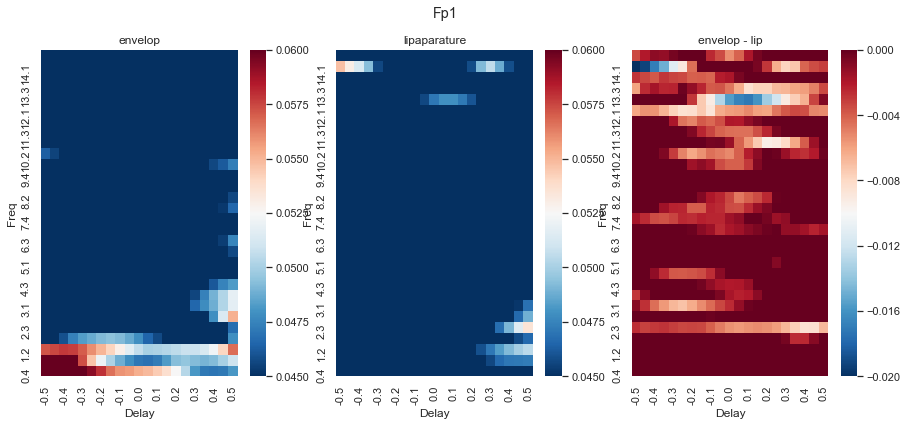

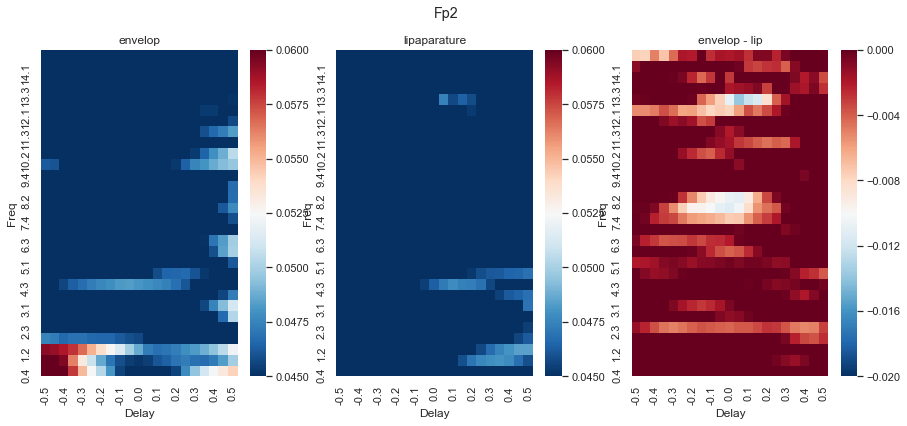

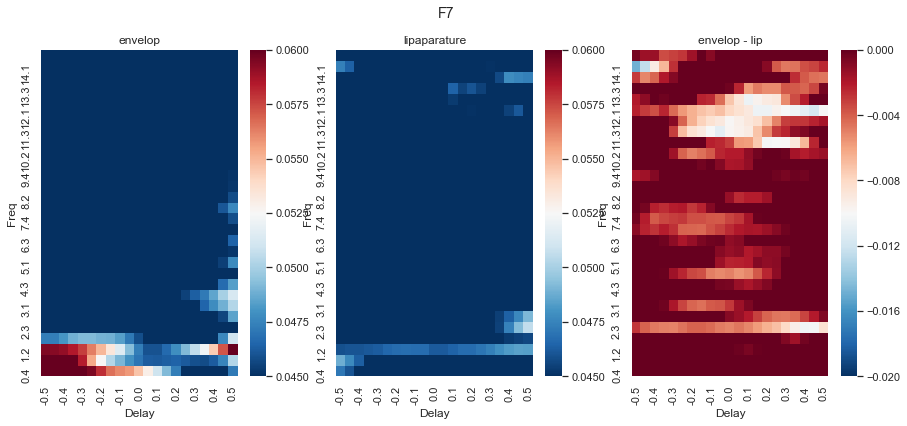

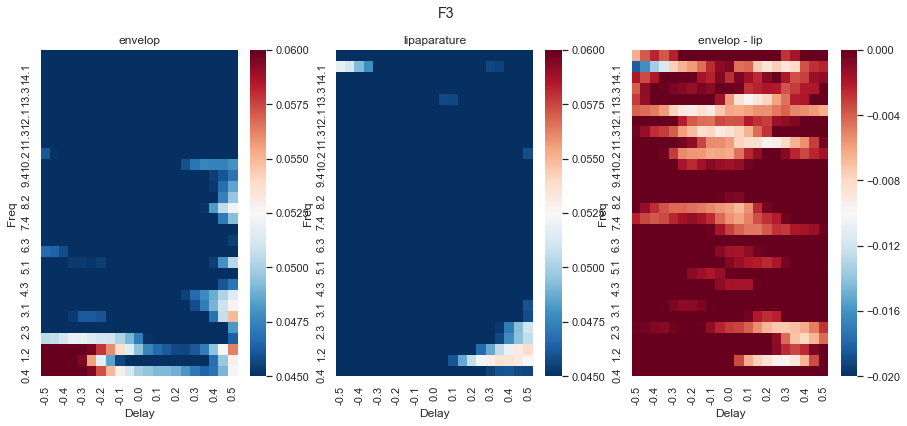

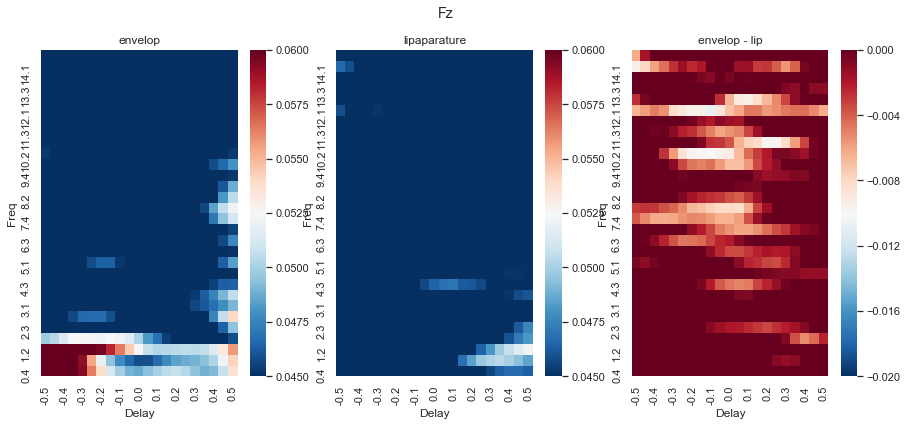

...

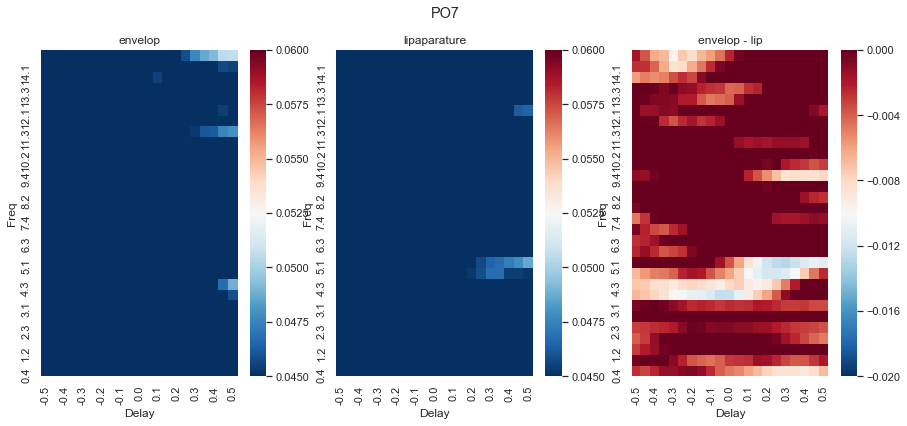

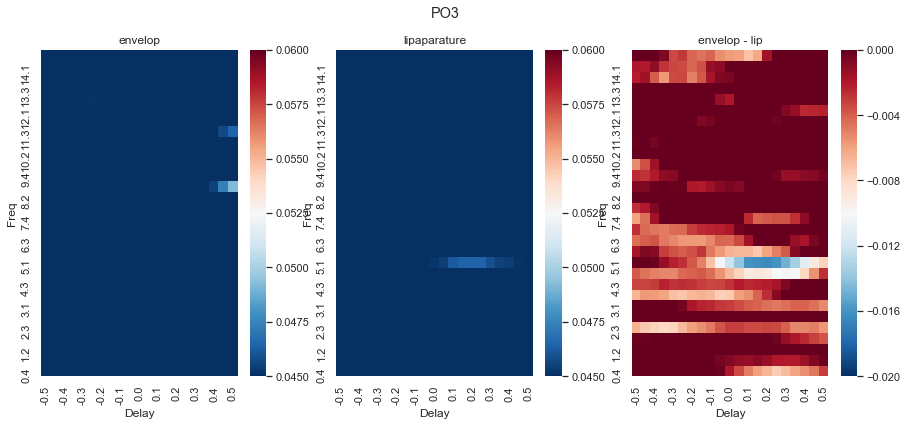

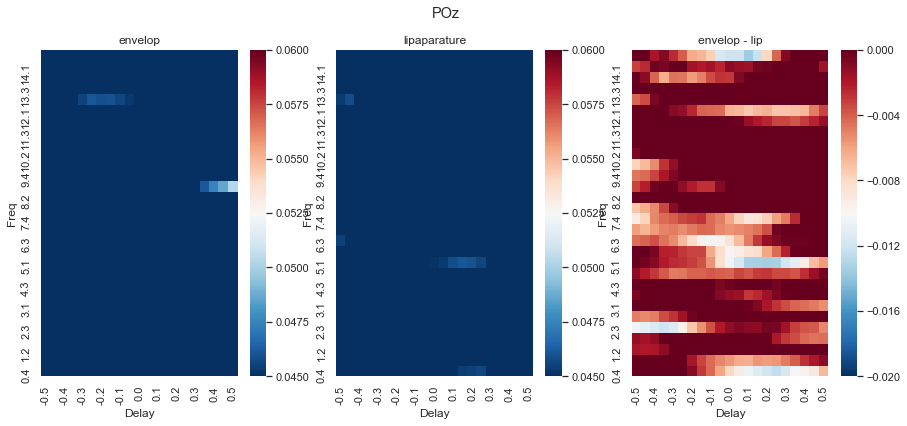

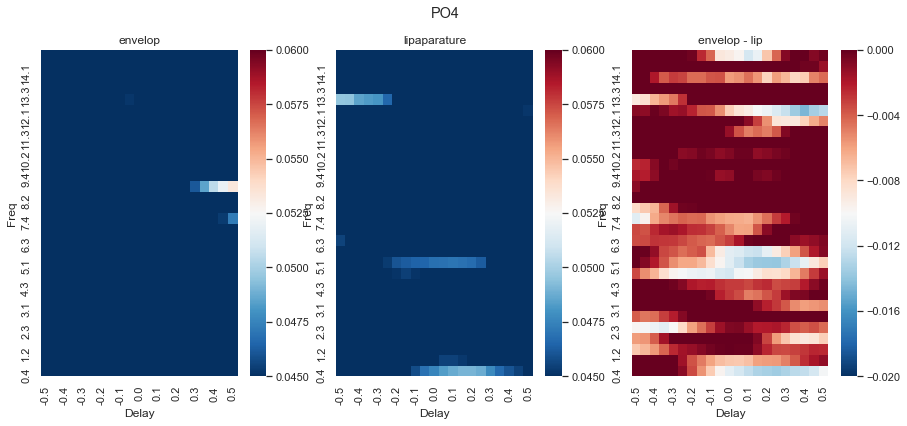

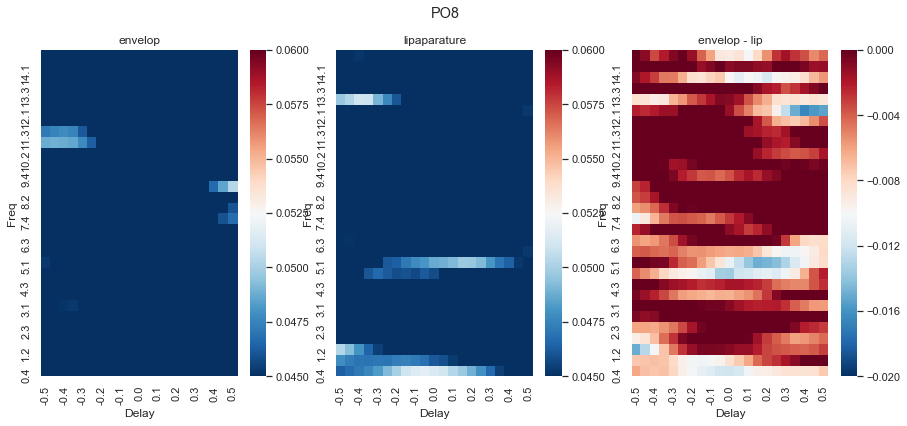

In [6]:
# freq delay heatmap for all feaarues
sns.set(font_scale=1)

for ch in info.ch_names:
    #ch = ['FC5','C5','CP5'] # Coherence 'C5','FC5','FC3'


    features = ['lipaparature']
    A = data.loc[features,freq,condition,delay,subject_name][ch]
    A = A.reset_index()
    a = A.groupby(['Feature','Freq','Delay'])[ch].mean().reset_index()
    a['data']=a[ch]

    features = ['envelop']
    B = data.loc[features,freq,condition,delay,subject_name][ch]
    B = B.reset_index()
    b = B.groupby(['Feature','Freq','Delay'])[ch].mean().reset_index()
    b['data']=b[ch]

    x=a.copy()
    x['data'] = b['data'].get_values() - a['data'].get_values()

    a = pd.DataFrame(a)
    a = a.pivot(index="Freq", columns="Delay", values='data')
    b = pd.DataFrame(b)
    b = b.pivot(index="Freq", columns="Delay", values='data')
    x = pd.DataFrame(x)
    x = x.pivot(index="Freq", columns="Delay", values='data')


    vmax= 0.06
    vmin= 0.045

    cmap='RdBu_r'
    f, AX = plt.subplots(figsize=(15,6))
    plt.subplot(1,3,2)
    ax = sns.heatmap(a, vmin = vmin, vmax=vmax,cmap = cmap)
    ax.invert_yaxis()
    plt.title('lipaparature')
    plt.subplot(1,3,1)
    ax = sns.heatmap(b,  vmin = vmin, vmax=vmax, cmap = cmap)
    ax.invert_yaxis()
    plt.title('envelop')
    plt.subplot(1,3,3)
    ax = sns.heatmap(x, vmin = -0.02, vmax=0, cmap = cmap)
    ax.invert_yaxis()
    plt.title('envelop - lip')
    plt.suptitle(ch)

In [6]:
ch = ['FC5','FC3','FC4','FC6','C6','C4'] # FC5  Coherence
ch = ['Coherence'] # FC5  Coherence

vmax= 0.06
vmin= 0.04

Text(0.5, 0.98, "['Coherence']")

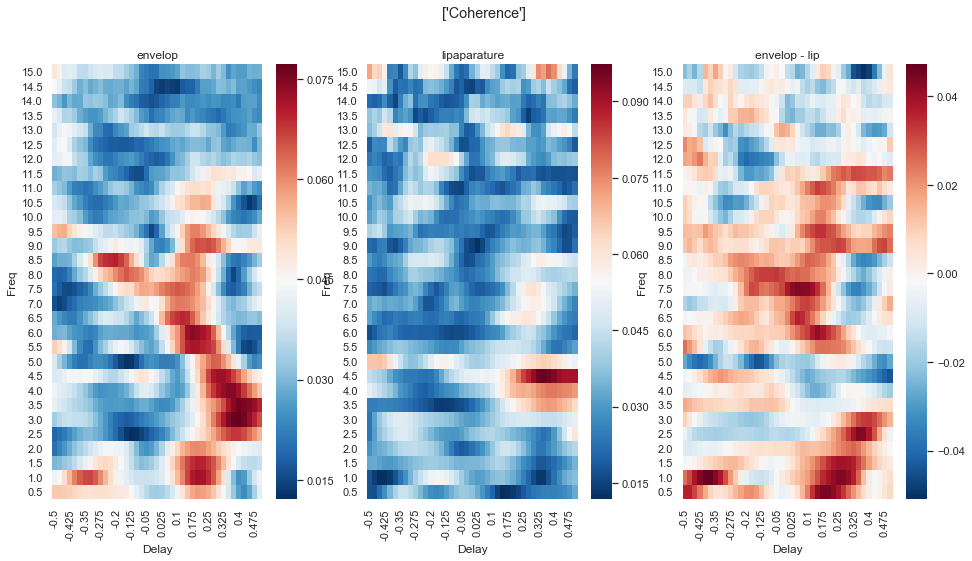

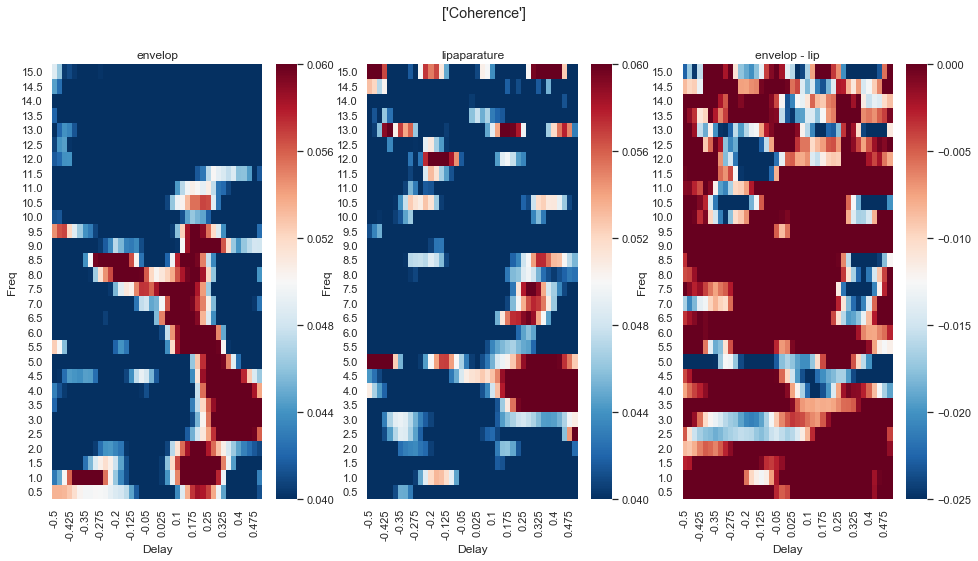

In [7]:
# freq delay heatmap for all feaarues
sns.set(font_scale=1)


features = ['lipaparature']
A = data.loc[features,freq,condition,delay,subject_name][ch]
A = A.reset_index()
a = A.groupby(['Feature','Freq','Delay'])[ch].mean().reset_index()
a['data']=a[ch].mean(axis=1)

features = ['envelop']
B = data.loc[features,freq,condition,delay,subject_name][ch]
B = B.reset_index()
b = B.groupby(['Feature','Freq','Delay'])[ch].mean().reset_index()
b['data']=b[ch].mean(axis=1)

x=a.copy()
x['data'] = b['data'].get_values() - a['data'].get_values()

a = pd.DataFrame(a)
a = a.pivot(index="Freq", columns="Delay", values='data')
b = pd.DataFrame(b)
b = b.pivot(index="Freq", columns="Delay", values='data')
x = pd.DataFrame(x)
x = x.pivot(index="Freq", columns="Delay", values='data')

cmap='RdBu_r'
f, AX = plt.subplots(figsize=(16,8))
plt.subplot(1,3,2)
ax = sns.heatmap(a, cmap = cmap)
ax.invert_yaxis()
plt.title('lipaparature')
plt.subplot(1,3,1)
ax = sns.heatmap(b,  cmap = cmap)
ax.invert_yaxis()
plt.title('envelop')
plt.subplot(1,3,3)
ax = sns.heatmap(x,cmap = cmap)
ax.invert_yaxis()
plt.title('envelop - lip')
plt.suptitle(ch)


cmap='RdBu_r'
f, AX = plt.subplots(figsize=(16,8))
plt.subplot(1,3,2)
ax = sns.heatmap(a, vmin = vmin, vmax=vmax,cmap = cmap)
ax.invert_yaxis()
plt.title('lipaparature')
plt.subplot(1,3,1)
ax = sns.heatmap(b,  vmin = vmin, vmax=vmax, cmap = cmap)
ax.invert_yaxis()
plt.title('envelop')
plt.subplot(1,3,3)
ax = sns.heatmap(x, vmin = -0.025, vmax=0,cmap = cmap)
ax.invert_yaxis()
plt.title('envelop - lip')
plt.suptitle(ch)

In [74]:
delay

array([-0.5  , -0.475, -0.45 , -0.425, -0.4  , -0.375, -0.35 , -0.325,
       -0.3  , -0.275, -0.25 , -0.225, -0.2  , -0.175, -0.15 , -0.125,
       -0.1  , -0.075, -0.05 , -0.025,  0.   ,  0.025,  0.05 ,  0.075,
        0.1  ,  0.125,  0.15 ,  0.175,  0.2  ,  0.225,  0.25 ,  0.275,
        0.3  ,  0.325,  0.35 ,  0.375,  0.4  ,  0.425,  0.45 ,  0.475,
        0.5  ])

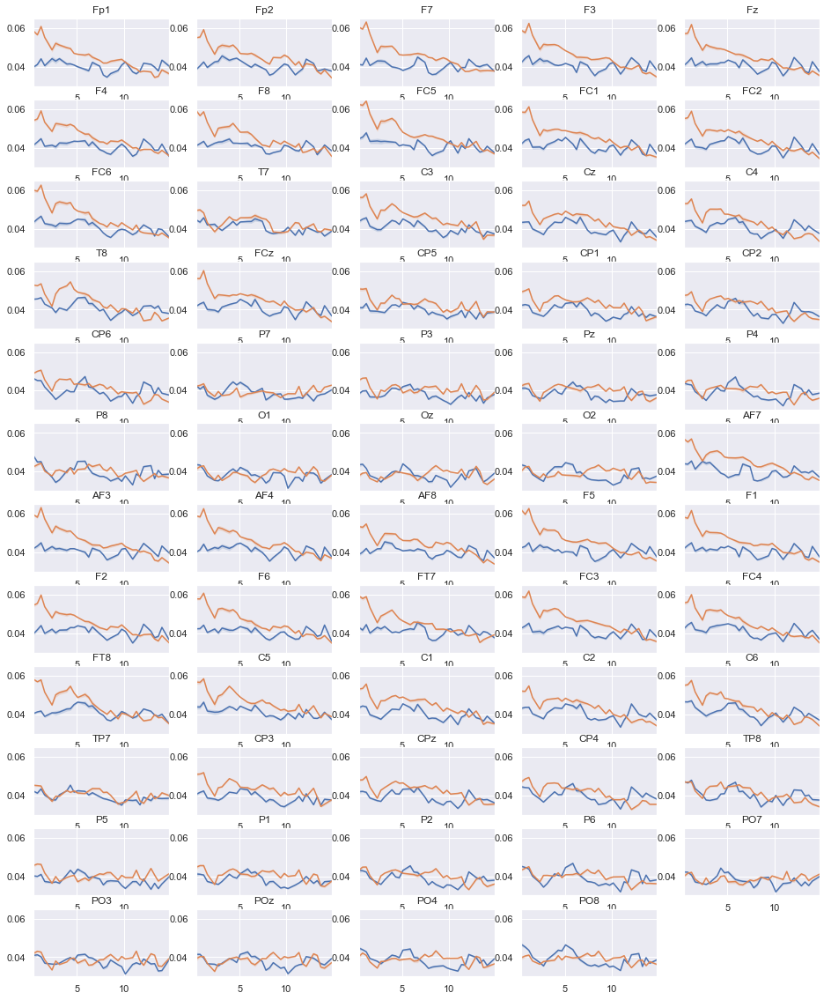

In [297]:
# avg delay all channels
sns.set(font_scale=1)

f, ax = plt.subplots(figsize=(16,20))

for i in range(0,len(info.ch_names)):
    ch  = info.ch_names[i]
    features = ['lipaparature']
    A = data.loc[features,freq,condition,delay,subject_name][ch]
    A = A.reset_index()
    a = A.groupby(['Feature','Freq','Delay'])[ch].mean().reset_index()
    a['data']=a[ch]

    features = ['envelop']
    B = data.loc[features,freq,condition,delay,subject_name][ch]
    B = B.reset_index()
    b = B.groupby(['Feature','Freq','Delay'])[ch].mean().reset_index()
    b['data']=b[ch]

    x=a.copy()
    x['data'] = b['data'].get_values() - a['data'].get_values()

    a = pd.DataFrame(a)
    a = a.pivot(index="Freq", columns="Delay", values='data')
    b = pd.DataFrame(b)
    b = b.pivot(index="Freq", columns="Delay", values='data')
    x = pd.DataFrame(x)
    x = x.pivot(index="Freq", columns="Delay", values='data')


    x=a.get_values().mean(axis=1)
    x_std=a.get_values().std(axis=1) / np.sqrt(len(x))

    y=b.get_values().mean(axis=1)
    y_std=a.get_values().std(axis=1) / np.sqrt(len(y))

    plt.subplot(12,5,i+1)

    plt.plot(freq,x)
    plt.fill_between(freq, x - x_std, x + x_std,alpha=0.2)

    plt.plot(freq,y)
    plt.fill_between(freq, y - y_std, y + y_std,alpha=0.2)
    #plt.xlabel('Frequency')
    plt.xlim([freq[0],freq[-1]])
    plt.ylim([0.03,0.065])
    plt.title(ch)


In [8]:
ch = 'Coherence'
delay = np.arange(-5,5.5,0.5) / 10
delay = np.arange(-5,5.25,0.25) / 10


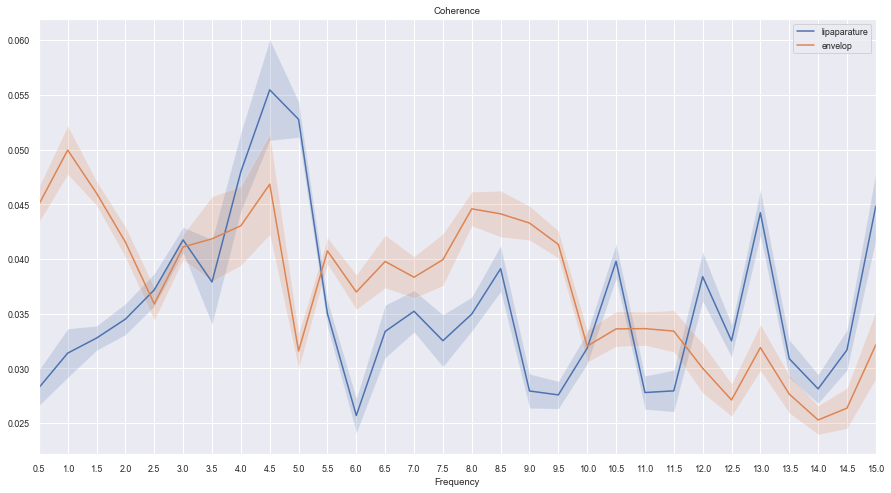

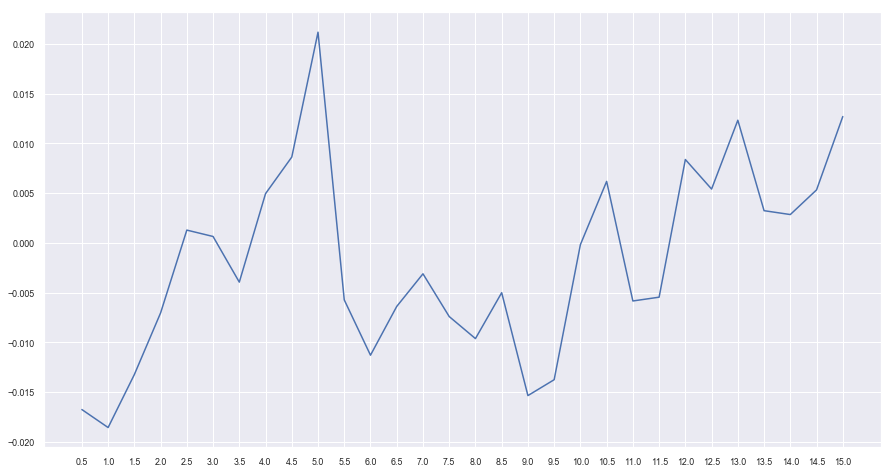

In [9]:
#
sns.set(font_scale=0.8)

features = ['lipaparature']
A = data.loc[features,freq,condition,delay,subject_name][ch]
A = A.reset_index()
a = A.groupby(['Feature','Freq','Delay'])[ch].mean().reset_index()
a['data']=a[ch]

features = ['envelop']
B = data.loc[features,freq,condition,delay,subject_name][ch]
B = B.reset_index()
b = B.groupby(['Feature','Freq','Delay'])[ch].mean().reset_index()
b['data']=b[ch]

x=a.copy()
x['data'] = b['data'].get_values() - a['data'].get_values()

a = pd.DataFrame(a)
a = a.pivot(index="Freq", columns="Delay", values='data')
b = pd.DataFrame(b)
b = b.pivot(index="Freq", columns="Delay", values='data')
x = pd.DataFrame(x)
x = x.pivot(index="Freq", columns="Delay", values='data')

x=a.get_values().mean(axis=1)
x_std=a.get_values().std(axis=1) / np.sqrt(len(x))

y=b.get_values().mean(axis=1)
y_std=a.get_values().std(axis=1) / np.sqrt(len(y))

f, ax = plt.subplots(figsize=(15,8))
plt.plot(freq,x)
plt.fill_between(freq, x - x_std, x + x_std,alpha=0.2)
plt.xlabel('Frequency')


plt.plot(freq,y)
plt.fill_between(freq, y - y_std, y + y_std,alpha=0.2)
plt.xlabel('Frequency')

plt.xlim([freq[0],freq[-1]])
plt.legend(['lipaparature','envelop'])
plt.title(ch)
cc=np.unique(A['Freq'])

_=plt.xticks(cc)


f, ax = plt.subplots(figsize=(15,8))
plt.plot(freq,x-y)
_=plt.xticks(cc)


In [10]:
dd = 0


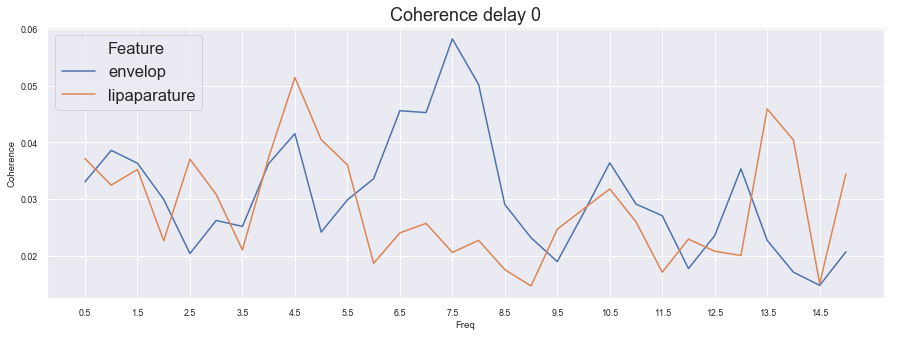

In [11]:
# channel avg in one delay
A=data.reset_index()
features = ['envelop','lipaparature']

a = A[(A['Condition']=='All')& (A['Delay']==dd)& (A['Feature'].isin(features))]

f, ax = plt.subplots(figsize=(15,5))

sns.set(font_scale=1.5)

_=sns.lineplot(data=a,x="Freq", hue="Feature",y=ch)
_=plt.title(ch+' delay '+str(dd))

cc=np.unique(A['Freq'])

_=plt.xticks(cc[::2])

In [12]:
VMIN=-0.02
VMAX=0
delayd = np.arange(-5,5.5,0.5) / 10
FREQ = freq[:20]

DELAY = np.arange(-5,5.5,0.5) / 10

FREQ

array([ 0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5,  5. ,  5.5,
        6. ,  6.5,  7. ,  7.5,  8. ,  8.5,  9. ,  9.5, 10. ])

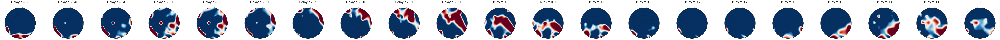

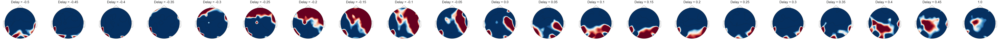

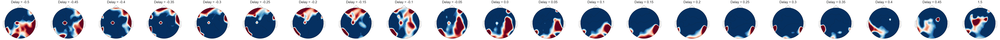

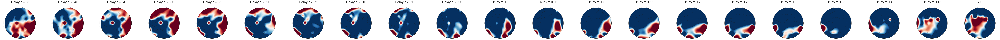

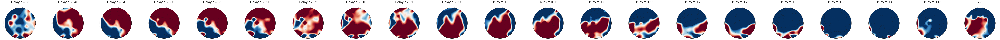

...

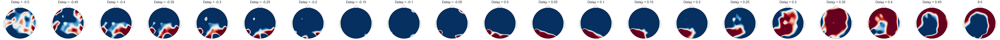

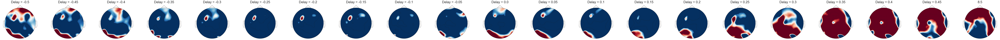

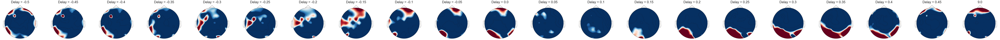

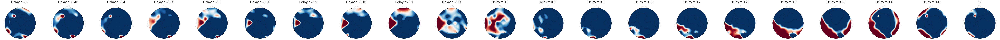

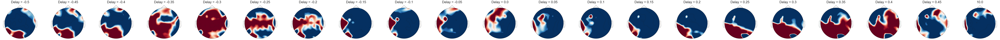

In [13]:
# topo plot

def get_data_for_clusterpermutation(data1,data2,f1,f2,freq_band,condition,delay,subject_name):
    frame1 =[]
    frame2 =[]
    for d in delay:
        aa=[]
        bb=[]
        for f in freq_band:            
            A = np.stack(data1.loc[f1,f,condition,d,subject_name]['Data'].get_values())
            B = np.stack(data2.loc[f2,f,condition,d,subject_name]['Data'].get_values())
            aa.append(A)
            bb.append(B)

        condition1 = np.mean(np.stack(aa),axis=0)
        condition2 = np.mean(np.stack(bb),axis=0)

        frame1.append(condition1)
        frame2.append(condition2)

    condition1 = np.swapaxes(frame1,0,1)
    condition2 = np.swapaxes(frame2,0,1)
    
    return condition1,condition2

def plot_topo_image3(df,vmin,vmax,typeF):
    fg = sns.FacetGrid(df,col=typeF,height =6,col_wrap=21)
    b = fg.map_dataframe(draw_heatmap2, 'Data')
    b = b.set_xlabels('')
    return b
    
def draw_heatmap2(*args, **kwargs):
    data = kwargs.pop('data')
    x = data['Data'].any() 
    mne.viz.plot_topomap(x, info.info, show=False,cmap='RdBu',
                         sensors =True,show_names=False,names=info.ch_names,
                        vmin=VMIN,vmax=VMAX)
    
delay = np.arange(-5,5.5,0.5) / 10
features = ['envelop','lipaparature']


sns.set(font_scale=2.5)

AA=[]

for f in range(0,len(FREQ)):
    condition1,condition2=get_data_for_clusterpermutation(data,data,features[0],features[1],
                                                          [FREQ[f]],condition,
                                                          DELAY,subject_name)
    #print(condition1.shape)
    A=np.mean(condition1,axis=0)
    B=np.mean(condition2,axis=0)
    A=A-B

    frame = []
    for d in range(0,len(DELAY)):
        df = pd.DataFrame({'Data':[A[d,:]],'Delay':DELAY[d]})
        frame.append(df)
    df = pd.concat((frame),axis=0)

    aa = df.loc[df['Delay'].isin(DELAY)]
    
    plot_topo_image3(aa,VMIN,VMAX,'Delay')
    #AA.append()
    
    plt.title(FREQ[f])


        
        

In [102]:
FREQ = [6]
delayd = np.arange(-3,0,0.25) / 10
#delayd = delay

VMIN=-0.02
VMAX=0


(25, 41, 59)


Text(0.5, 0.98, "['envelop', 'lipaparature']")

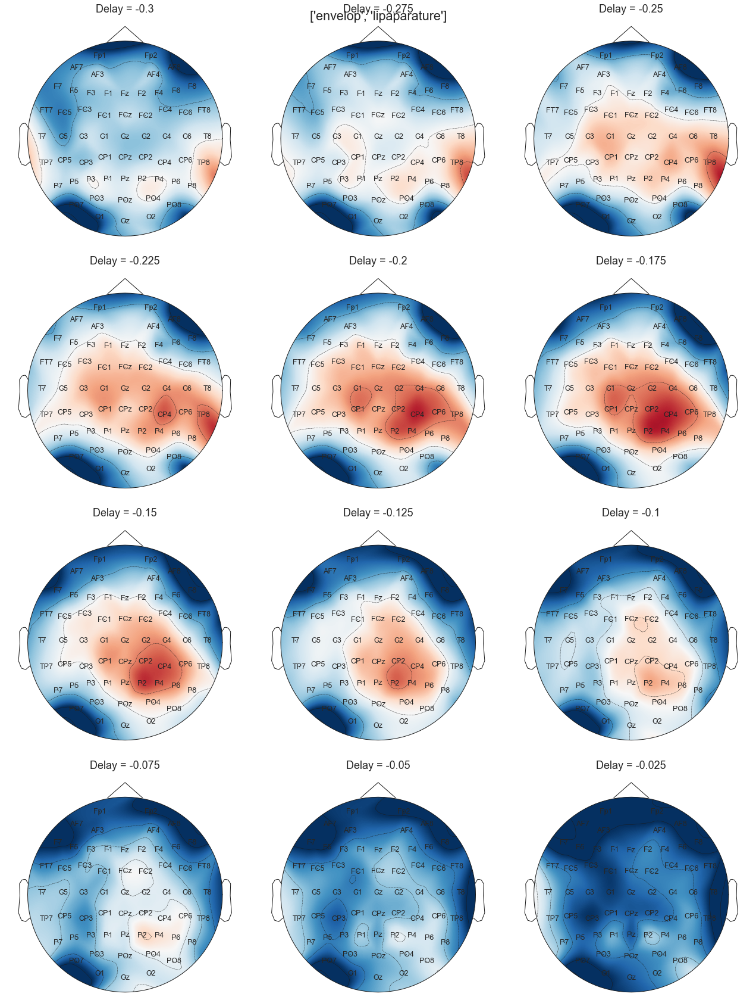

In [103]:
# topo plot
def get_data_for_clusterpermutation(data1,data2,f1,f2,freq_band,condition,delay,subject_name):
    frame1 =[]
    frame2 =[]
    for d in delay:
        aa=[]
        bb=[]
        for f in freq_band:
            A = np.stack(data1.loc[f1,f,condition,d,subject_name]['Data'].get_values())
            B = np.stack(data2.loc[f2,f,condition,d,subject_name]['Data'].get_values())
            aa.append(A)
            bb.append(B)

        condition1 = np.mean(np.stack(aa),axis=0)
        condition2 = np.mean(np.stack(bb),axis=0)

        frame1.append(condition1)
        frame2.append(condition2)

    condition1 = np.swapaxes(frame1,0,1)
    condition2 = np.swapaxes(frame2,0,1)
    
    return condition1,condition2

def plot_topo_image3(df,vmin,vmax,typeF):
    fg = sns.FacetGrid(df,col=typeF,height =6,col_wrap=3)
    b = fg.map_dataframe(draw_heatmap2, 'Data')
    b = b.set_xlabels('')
    
def draw_heatmap2(*args, **kwargs):
    data = kwargs.pop('data')
    x = data['Data'].any() 
    mne.viz.plot_topomap(x, info.info, show=False,cmap='RdBu',
                         sensors =True,show_names=True,names=info.ch_names,
                        vmin=VMIN,vmax=VMAX)
    
features = ['envelop','lipaparature']

condition1,condition2=get_data_for_clusterpermutation(data,data,features[0],features[1],
                                                      FREQ,condition,delay,subject_name)
print(condition1.shape)
A=np.mean(condition1,axis=0)
B=np.mean(condition2,axis=0)
A=A-B

frame = []
for d in range(0,len(delay)):
    df = pd.DataFrame({'Data':[A[d,:]],'Delay':delay[d]})
    frame.append(df)
df = pd.concat((frame),axis=0)

aa = df.loc[df['Delay'].isin(delayd)]

sns.set(font_scale=1.5)

plot_topo_image3(aa,VMIN,VMAX,'Delay')  
plt.suptitle(features)

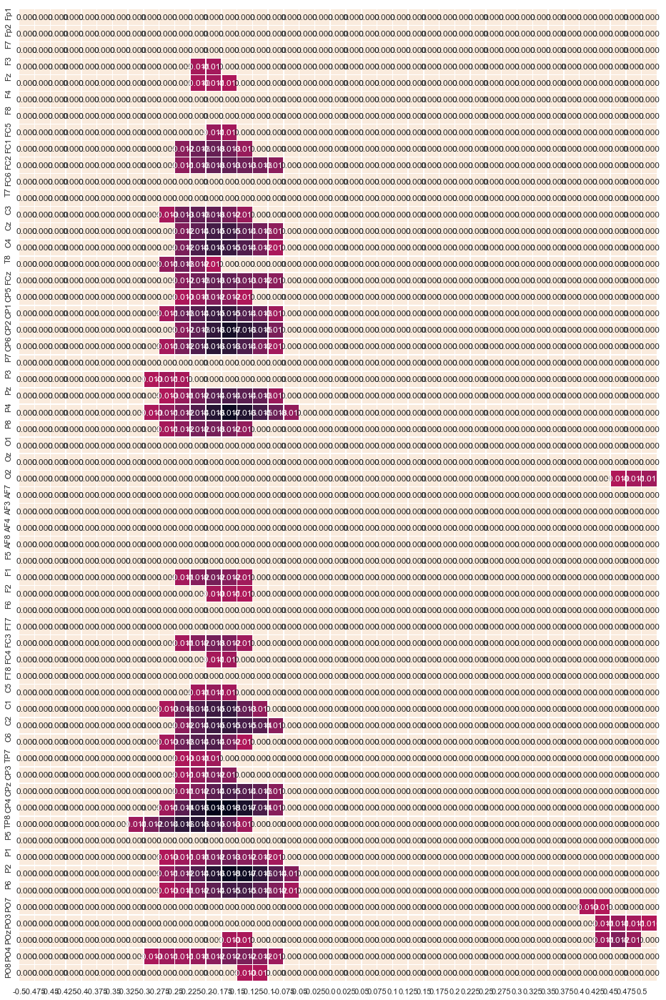

In [104]:
#
a=A.copy()
a[A>-0.01]=0
delay[np.argmax(np.min(a, axis=1))]

sns.set(font_scale=1)

f, ax = plt.subplots(figsize=(16,25))
sns.heatmap(a.T,linewidths=.5,cbar=False,annot=True, fmt=".3f")
_=plt.yticks(np.arange(0,59),info.ch_names)
_=plt.xticks(np.arange(0,len(delay)),delay)

In [105]:
print(delay[np.argmin(np.min(a, axis=1))])
info.ch_names[np.argmin(np.min(a, axis=0))]


-0.2


'CP4'

In [109]:
CH = ['AF7','FC5','FT7','T7','TP7','C5'] # FC5  Coherence
CH = ['C5','FC5','C4','FC6','C6','C3'] # FC5  Coherence
#CH = ['C5','C6','C3','C4'] # FC5  Coherence
#CH = ['Coherence'] # FC5  Coherence
CH = ['P5','P7','P2','PO4'] # FC5  Coherence
CH = ['FC5','FC3','FC4','FC6','C6','C4'] # FC5  Coherence
CH = ['C5'] # FC5  Coherence
CH = [info.ch_names[np.argmin(np.min(a, axis=0))]]
CH = ['Coherence'] # FC5  Coherence

In [110]:
subject_name = ['Alice','Andrea','Daniel','Elena','Elenora','Elisa','Federica','Francesca',
                'Gianluca1','Giada','Giorgia','Jonluca','Laura','Leonardo','Linda','Lucrezia',
                'Manu','Marco','Martina','Pagani','Pasquale','Sara',
                'Silvia','Silvia2','Tommaso']

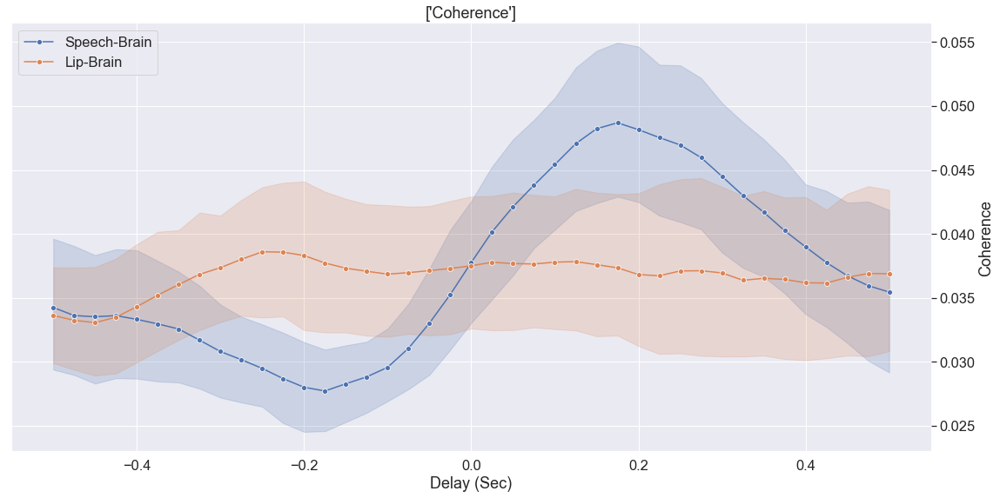

In [111]:
# figure3B
def plot_delay_avg(data,delay,features,freq,condition,subject_name,ch):    
   # a = data.loc[features,freq,condition,delay,subject_name][['FC5','C5','CP5','T7']].get_values()
   # aa = np.mean(a,axis=1)
   # data['Coherence'] =  pd.Series(aa, index=data.index)
    
    
    a = data.loc[features,freq,condition,delay,subject_name][ch]
    a = a.groupby(['Feature',"Condition","Subject",'Delay']).mean().reset_index()

    a = a.reset_index()
    a['data']=a[ch].mean(axis=1)
    
    g = sns.FacetGrid(a,  row="Condition",margin_titles=False,height=8,aspect=2)
    #b = g.map_dataframe(sns.tsplot, time="Delay", unit="Subject",condition="Feature",value='data',color="deep",marker='o')
    b = g.map_dataframe(sns.lineplot, x="Delay",hue="Feature", y="data",color="deep",marker='o')
    b = b.set_xlabels('Delay (Sec)')
    
    b.ax.yaxis.tick_right()
    b.ax.yaxis.set_label_position("right")
    b.set_ylabels('Coherence')
    
    return a
    
sns.set(font_scale=1.5)
sns.set_style("darkgrid")
#sns.set_style("white")


features = ['envelop','lipaparature']

A = plot_delay_avg(data,delay,features,FREQ,condition,subject_name,CH)

#plt.legend(['Speech-Brain','Lip-Brain'],loc=2)
#plt.title('Freq = 1 - 4 Hz')
#plt.ylim([0.024, 0.07])
plt.title(CH)
plt.xlabel('Delay (Sec)')

#plt.axhline(y=0.025, xmin=0.45, xmax=0.6, linewidth=5, color = 'r')
#plt.axhline(y=0.025, xmin=0.7, xmax=0.95, linewidth=5, color = 'b')
#plt.legend(['Speech-Brain','Lip-Brain','Lip > Speech','Speech > Lip'],loc=2)
plt.legend(['Speech-Brain','Lip-Brain'],loc=2)
#plt.savefig('fig3b.eps', transparent=True, format='eps', dpi=300)

In [86]:
# t-test
B=[]
for i in range(0,len(delay)):
    a = A[(A['Feature']=='envelop')&(A['Delay']==delay[i])]['data']
    b = A[(A['Feature']=='lipaparature')&(A['Delay']==delay[i])]['data']
    a,b = stats.ttest_ind(a,b)
    B.append((delay[i],a,b))

B=np.stack(B)
B[B[:,2]>0.05,:]=np.nan
np.round(B,2)

array([[  nan,   nan,   nan],
       [  nan,   nan,   nan],
       [  nan,   nan,   nan],
       [  nan,   nan,   nan],
       [  nan,   nan,   nan],
       [  nan,   nan,   nan],
       [  nan,   nan,   nan],
       [  nan,   nan,   nan],
       [  nan,   nan,   nan],
       [-0.05, -2.26,  0.03],
       [ 0.  , -3.06,  0.  ],
       [ 0.05, -2.43,  0.02],
       [  nan,   nan,   nan],
       [  nan,   nan,   nan],
       [ 0.2 ,  3.7 ,  0.  ],
       [ 0.25,  5.24,  0.  ],
       [ 0.3 ,  6.01,  0.  ],
       [ 0.35,  5.38,  0.  ],
       [ 0.4 ,  3.76,  0.  ],
       [ 0.45,  2.09,  0.04],
       [  nan,   nan,   nan]])

Text(0.5, 0.98, '[6.64] Coherence')

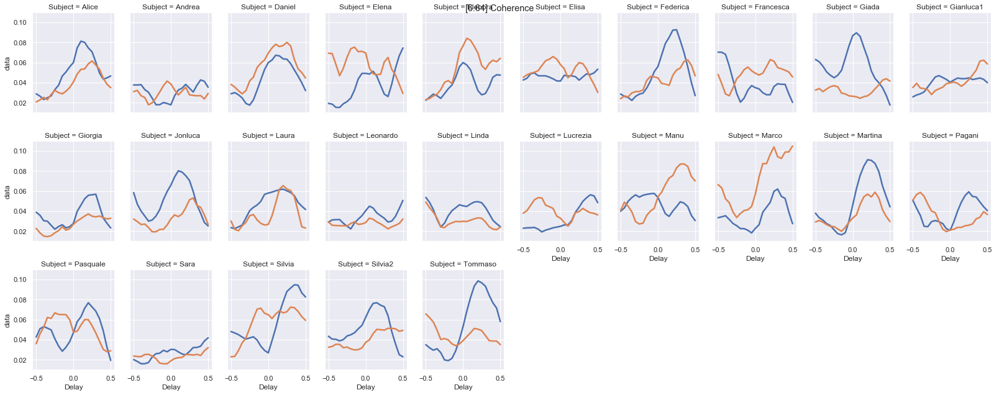

In [180]:
# subjectwise investigation
a = data.loc[features,FREQ,condition,delay,subject_name][CH]
a = a.groupby(['Feature',"Condition","Subject",'Delay']).mean().reset_index()

a = a.reset_index()
a['data']=a[CH].mean(axis=1)

sns.set(font_scale=1)

b = sns.relplot(x="Delay", y="data", hue="Feature",col="Subject", col_wrap=10,
                height=3, aspect=.75, linewidth=2.5,legend=False,
        kind="line", data=a);

plt.suptitle(str(FREQ)+' '+' '.join(CH))